In [1]:
import dlib
import cv2
import pandas as pd
import glob
from skimage import io
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
filename = 'test_face.jpg'
face_detector = dlib.get_frontal_face_detector()
image = cv2.imread(filename)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
detected_faces = face_detector(image, 1)

In [3]:
def align_face(image_path, shape_predictor_path):
    detector = dlib.get_frontal_face_detector()
    predictor = dlib.shape_predictor(shape_predictor_path)
    
    img = io.imread(image_path)
    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
    
    faces = detector(img)
    aligned_faces = []
    
    for face in faces:
        shape = predictor(img, face)
        aligned_img = dlib.get_face_chip(img, shape)
        aligned_bgr = cv2.cvtColor(aligned_img, cv2.COLOR_RGB2BGR)
        aligned_faces.append(aligned_bgr)
    
    return aligned_faces

aligned_faces = align_face(
    image_path=filename,
    shape_predictor_path="shape_predictor_68_face_landmarks.dat"
)
for idx, face in enumerate(aligned_faces):
    cv2.imshow(f"Aligned Face {idx}", face)
    cv2.waitKey(0)
cv2.destroyAllWindows()

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's

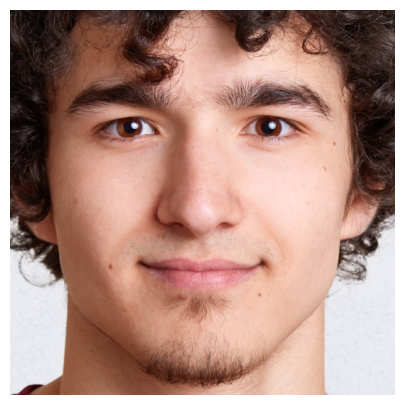

In [4]:
detector = dlib.get_frontal_face_detector()
shape_predictor = dlib.shape_predictor("shape_predictor_68_face_landmarks.dat")

def process_and_display(image):
    img_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    annotated_img = np.copy(image)
    
    detected_faces = detector(img_rgb)
    if not detected_faces:
        print("No faces detected.")
        return
    
    num_faces = len(detected_faces)
    fig, axes = plt.subplots(nrows=1, ncols=num_faces, figsize=(15, 5))  # Ensure axes is an array
    
    for i, face_rect in enumerate(detected_faces):
        cv2.rectangle(
            annotated_img,
            (face_rect.left(), face_rect.top()),
            (face_rect.right(), face_rect.bottom()),
            (0, 255, 70),
            3
        )
        
        shape = shape_predictor(img_rgb, face_rect)
        for part in shape.parts():
            cv2.circle(annotated_img, (part.x, part.y), 1, (255, 0, 0), -1)
        
        aligned_face = dlib.get_face_chip(img_rgb, shape, size=534)
        
        if num_faces == 1:
            ax = axes  
        else:
            ax = axes[i] 
        ax.imshow(aligned_face)
        ax.axis('off')
    
    plt.figure(figsize=(annotated_img.shape[1] / 25, annotated_img.shape[0] / 25))
    plt.imshow(cv2.cvtColor(annotated_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

image = cv2.imread('test_face.jpg')
process_and_display(image)

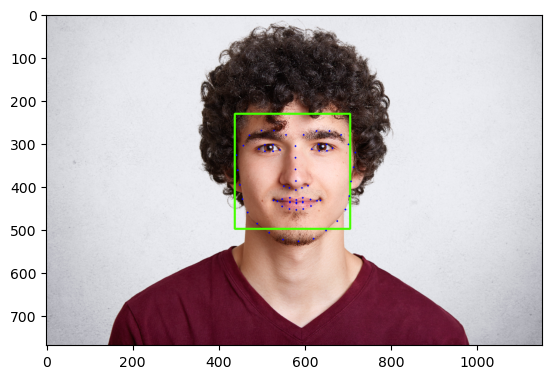

In [5]:
image = cv2.imread(filename)  
scale_percent = 20  
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
image = cv2.resize(image, (width, height))  

rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

detected_faces = face_detector(rgb_image, 1)
for f in detected_faces:
    cv2.rectangle(image, (f.left(), f.top()), (f.right(), f.bottom()), (0, 255, 70), 3)
    pose_landmarks = shape_predictor(rgb_image, f)
    for p in pose_landmarks.parts():
        cv2.circle(image, (p.x, p.y), 2, (255, 0, 0), -1)

plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.show()

## Encoding faces

In [6]:
face_recognition_model_path = "dlib_face_recognition_resnet_model_v1.dat"
face_encoder = dlib.face_recognition_model_v1(face_recognition_model_path)

In [7]:
face_encoding = np.array(face_encoder.compute_face_descriptor(image, pose_landmarks, 1))

In [8]:
a = np.array(face_encoder.compute_face_descriptor(image, pose_landmarks, 1))

### Training 

In [9]:
from sklearn.svm import SVC
from sklearn.preprocessing import LabelEncoder

In [10]:
# from simple_image_download import simple_image_download as simp

# response = simp.simple_image_download
# response().download("Emma Watson", 55) 

In [11]:
def align_face(img, shape_predictor):
    detector = dlib.get_frontal_face_detector()
    if len(img.shape) == 2:
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    elif img.shape[2] == 4:
        img = cv2.cvtColor(img, cv2.COLOR_RGBA2RGB)
    
    faces = detector(img)
    aligned_faces = []
    
    for face in faces:
        shape = shape_predictor(img, face)
        aligned_img = dlib.get_face_chip(img, shape)
        aligned_bgr = cv2.cvtColor(aligned_img, cv2.COLOR_RGB2BGR)
        aligned_faces.append(aligned_bgr)
    
    return aligned_faces

def process_image(filename, scale_factor=1.0):
    image = cv2.imread(filename)
    if image is None:
        print(f"Failed to read {filename}")
        return None
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (0,0), fx=scale_factor, fy=scale_factor)
    aligned_faces = align_face(image, shape_predictor)
    
    encodings = []
    for aligned_face in aligned_faces:
        aligned_rgb = cv2.cvtColor(aligned_face, cv2.COLOR_BGR2RGB)
        faces = face_detector(aligned_rgb, 1)
        if len(faces) != 1:
            continue
        landmarks = shape_predictor(aligned_rgb, faces[0])
        encoding = face_encoder.compute_face_descriptor(
            aligned_rgb, landmarks, 10
        )
        encodings.append(np.array(encoding))
    
    return encodings

df = pd.DataFrame()
characters = ['Daniel_Radcliffe','Emma_Watson','Robert_Pattinson']
for char in characters:
    for filename in glob.glob(f"simple_images/{char}/*"):
        print(filename)
        encodings = process_image(filename, scale_factor=0.5)
        if encodings:
            label = filename.split("/")[1]
            for encoding in encodings:
                temp_df = pd.DataFrame([encoding])
                temp_df['label'] = label
                df = pd.concat([df, temp_df], ignore_index=True)

simple_images/Daniel_Radcliffe/Daniel Radcliffe_16.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_13.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_50.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_18.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_4.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_6.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_43.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_30.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_20.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_34.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_24.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_9.jpg
Failed to read simple_images/Daniel_Radcliffe/Daniel Radcliffe_9.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_29.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_38.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_28.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_41.jpg
simple_images/Daniel_Radcliffe/Daniel Radcliffe_45.jpg

In [12]:
df

,0,1,2,3,4,5,6,7,8,9,...,119,120,121,122,123,124,125,126,127,label
0,-0.151655,0.106506,0.040927,-0.089471,-0.198905,0.053837,-0.027458,-0.016795,0.188958,-0.127683,...,0.002237,0.027273,-0.037802,-0.118548,-0.081940,0.059225,-0.025418,0.112207,0.040686,Daniel_Radcliffe
1,-0.076181,0.042522,0.024634,-0.131119,-0.121678,-0.005427,-0.048493,0.023316,0.159215,-0.036439,...,0.020560,-0.012769,-0.046570,-0.169887,-0.088314,0.091483,-0.052679,0.089996,0.079805,Daniel_Radcliffe
2,-0.103383,0.148253,0.078799,-0.112584,-0.118319,0.015720,-0.078302,0.003045,0.146332,-0.053339,...,0.006133,0.062563,-0.050486,-0.087628,-0.089541,0.075259,-0.030401,0.088910,0.068418,Daniel_Radcliffe
3,-0.118859,0.097305,0.035478,-0.154795,-0.148921,0.015563,-0.026700,0.001422,0.145218,-0.057069,...,-0.022753,0.060133,-0.085752,-0.197389,-0.098420,0.121811,-0.074306,0.076105,0.063811,Daniel_Radcliffe
4,-0.083228,0.074640,0.070870,-0.158882,-0.106210,0.044419,-0.032646,0.028649,0.130656,-0.037763,...,0.037905,-0.040992,-0.049001,-0.173134,-0.131476,0.051932,-0.064865,0.081367,0.078622,Daniel_Radcliffe
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143,-0.068934,0.181538,0.064096,-0.082508,-0.144523,0.011363,-0.071340,0.017369,0.184786,-0.014285,...,0.055318,-0.010334,-0.089151,-0.125148,-0.144227,0.069685,-0.072973,0.061394,0.067028,Robert_Pattinson
144,-0.100749,0.127909,0.040220,-0.023726,-0.133691,-0.067433,-0.063137,-0.060434,0.148773,-0.014957,...,0.032414,0.001574,-0.061624,-0.060347,-0.123824,0.093552,-0.049160,0.113011,0.047489,Robert_Pattinson
145,-0.096395,0.081412,0.081680,-0.119018,-0.124244,-0.067625,-0.003382,0.003560,0.188614,-0.012658,...,0.010318,-0.011779,-0.172033,-0.099722,-0.096794,0.121884,-0.040074,0.084366,0.017252,Robert_Pattinson
146,-0.078445,0.187557,0.084028,-0.080928,-0.110660,0.023994,-0.079525,0.006601,0.191832,-0.001687,...,0.038045,0.037162,-0.083082,-0.073529,-0.129856,0.135051,-0.050252,0.048322,0.050117,Robert_Pattinson


In [13]:
from sklearn.pipeline import make_pipeline
from sklearn.neighbors import KNeighborsClassifier

clf_knn = KNeighborsClassifier(n_neighbors=3, metric='cosine')

In [14]:
from sklearn.utils import shuffle
df = shuffle(df, random_state=42).reset_index(drop=True)

le = LabelEncoder()
y = le.fit_transform(df["label"])
print("{} classes.".format(len(le.classes_)))
X = df.drop("label", axis=1)
print('{} features for X'.format(len(X.columns)))

3 classes.
128 features for X


In [15]:
y

array([2, 0, 2, 0, 1, 0, 1, 0, 1, 0, 0, 1, 2, 1, 2, 1, 0, 1, 2, 0, 0, 1,
       0, 2, 0, 0, 1, 2, 1, 0, 2, 0, 2, 0, 0, 2, 2, 2, 0, 0, 0, 2, 1, 2,
       0, 1, 2, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 2, 1, 2, 0, 0, 1, 0, 1, 2,
       0, 1, 2, 0, 1, 1, 1, 2, 1, 0, 0, 2, 1, 0, 0, 1, 1, 0, 2, 0, 0, 1,
       1, 1, 2, 2, 1, 0, 0, 2, 2, 0, 0, 0, 1, 2, 0, 2, 1, 0, 1, 0, 2, 0,
       2, 0, 2, 1, 2, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 2, 2, 0, 2,
       0, 0, 2, 1, 1, 2, 1, 1, 2, 2, 0, 1, 1, 0, 1, 1])

In [16]:
clf = SVC(C=1, kernel='linear', probability=True)
clf.fit(X, y)

SVC(C=1, kernel='linear', probability=True)

In [17]:
clf_knn.fit(X, y)

KNeighborsClassifier(metric='cosine', n_neighbors=3)

0.9769958423887627


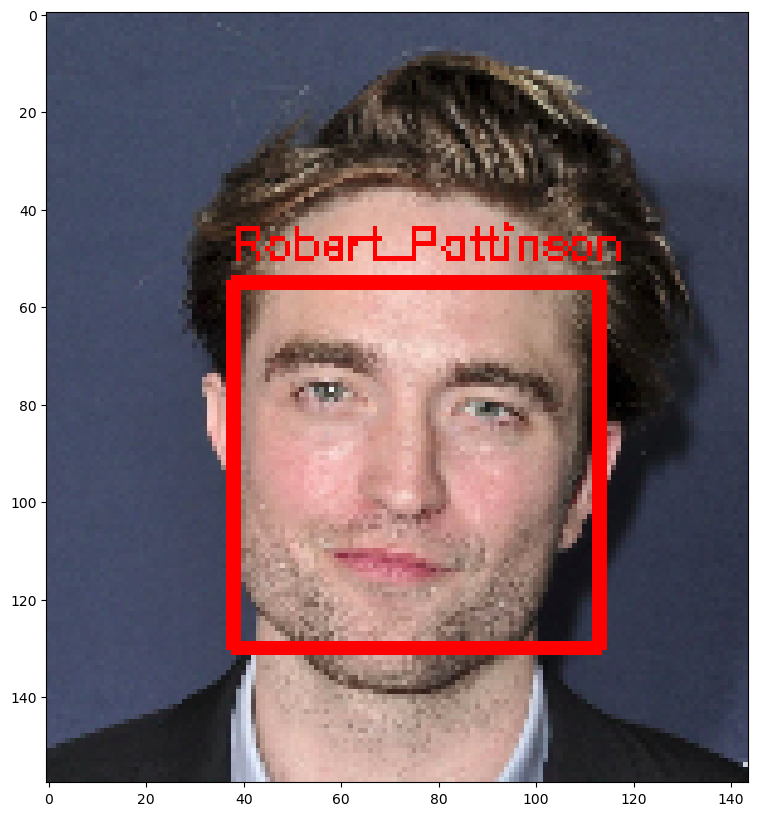

In [19]:
font = cv2.FONT_HERSHEY_SIMPLEX
# image = cv2.imread('face1.jpg')
image = cv2.imread('face2.png')
# image = cv2.imread('Emma Watson_7.jpg')
# image = cv2.imread('Emma Watson_19.jpg')
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
width = int(image.shape[1] * scale_percent / 100)
height = int(image.shape[0] * scale_percent / 100)
image = cv2.resize(image, (width, height))
img = np.copy(image)
detected_faces = face_detector(image, 1)
for face_detect in detected_faces:
    cv2.rectangle(img, (face_detect.left(), face_detect.top()), 
                      (face_detect.right(), face_detect.bottom()), (255, 0, 0), 2)
    pose_landmarks = shape_predictor(image, face_detect)
    face_encoding = np.array(face_encoder.compute_face_descriptor(image, pose_landmarks, 1))
    p = clf.predict_proba(face_encoding.reshape(1, 128))
    print(np.max(p))
    if np.max(p) > 0.8:
        y_pred = le.inverse_transform([np.argmax(p[0])])[0]
        cv2.putText(img, y_pred, (face_detect.left(), face_detect.top()-5), font, 0.3, (255, 0, 0))
plt.figure(figsize=(20,10))
plt.imshow(img)

### KNeighborsClassifier

In [20]:
def recognize_face(encoding, clf):
    if len(clf.classes_) == 1:  
        return clf.classes_[0], 1.0
        
    proba = clf.predict_proba([encoding])[0]
    max_idx = np.argmax(proba)
    return clf.classes_[max_idx], proba[max_idx]


def test_on_image(image_path, face_detector, shape_predictor, face_encoder, clf):
    image = cv2.imread(image_path)
    rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    detected_faces = face_detector(rgb_image, 1)
    if len(detected_faces) == 0:
        print("No faces detected in the image.")
        return None, None, image
    
    results = []
    for face in detected_faces:
        landmarks = shape_predictor(rgb_image, face)
        aligned_face = dlib.get_face_chip(rgb_image, landmarks)
        face_encoding = np.array(face_encoder.compute_face_descriptor(
            aligned_face, landmarks, 1 
        ))
        label, confidence = recognize_face(face_encoding, clf)
        cv2.rectangle(image, (face.left(), face.top()), 
                      (face.right(), face.bottom()), (0, 255, 0), 2)
        cv2.putText(image, f"{label} ({confidence:.2f})", 
                    (face.left(), face.top() - 10), 
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        
        results.append((label, confidence))
    return results[0][0], results[0][1], image

image_path = "face2.png"
label, confidence, output_image = test_on_image(
    image_path, face_detector, shape_predictor, face_encoder, clf_knn
)

print(f"Predicted Label: {label}, Confidence: {confidence}")
cv2.imshow("Output", output_image)
cv2.waitKey(0)
cv2.destroyAllWindows()

Predicted Label: 2, Confidence: 0.6666666666666666


QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's thread (0x2562d0c0).
Cannot move to target thread (0x31b8640)

QObject::moveToThread: Current thread (0x31b8640) is not the object's